# Import Libraries

In [ ]:
! pip install wandb

In [ ]:
import torch
import torch.nn as nn
import torchvision
import os
import PIL
import pdb
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from torchvision.utils import make_grid
from tqdm.auto import tqdm
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import wandb #pip install wandb
from mpl_toolkits.axes_grid1 import ImageGrid
from PIL import Image, ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True

# Visualization Function

In [ ]:
#wandb - weight and bias
def show(tensor, num=25, wandbactive=0, name=''):
    data = tensor.detach().cpu()
    grid = make_grid(data[:num], nrow=5).permute(1, 2, 0)
    
    #optional
    if(wandbactive==1):
        wandb.log({name:wandb.Image(grid.numpy().clip(0, 1))})
        
    plt.imshow(grid.clip(0, 1))
    plt.show()

# Load Dataset

In [ ]:
'''import gdown, zipfile

url = 'https://drive.google.com/uc?id=1cNIac61PSA_LqDFYFUeyaQYekYPc75NH'
path='/content/drive/MyDrive/Datasets'
download_path=f'{path}/img_align_celeba.zip'

if not os.path.exists(path):
  os.makedirs(path)

gdown.download(url, download_path, quiet=False)

with zipfile.ZipFile(download_path, 'r') as ziphandler:
  ziphandler.extractall(path)

#### Alternative download address:
# Celebra gdrive: https://drive.google.com/drive/folders/0B7EVK8r0v71pTUZsaXdaSnZBZzg?resourcekey=0-rJlzl934LzC-Xp28GeIBzQ
# Kaggle: https://www.kaggle.com/jessicali9530/celeba-dataset'''

"import gdown, zipfile\n\nurl = 'https://drive.google.com/uc?id=1cNIac61PSA_LqDFYFUeyaQYekYPc75NH'\npath='/content/drive/MyDrive/Datasets'\ndownload_path=f'{path}/img_align_celeba.zip'\n\nif not os.path.exists(path):\n  os.makedirs(path)\n\ngdown.download(url, download_path, quiet=False)\n\nwith zipfile.ZipFile(download_path, 'r') as ziphandler:\n  ziphandler.extractall(path)\n\n#### Alternative download address:\n# Celebra gdrive: https://drive.google.com/drive/folders/0B7EVK8r0v71pTUZsaXdaSnZBZzg?resourcekey=0-rJlzl934LzC-Xp28GeIBzQ\n# Kaggle: https://www.kaggle.com/jessicali9530/celeba-dataset"

# Parameters & Hyper-Parameters

In [ ]:
data_path = '/content/drive/MyDrive/Face_Generation_GAN/img_align_celeba/'
checkpt_path ='/content/drive/MyDrive/Face_Generation_GAN/'
#critic = Discriminator
epochs = 10000
batch_size = 128
lr = 1e-4
z_dim=200
device = torch.device("cuda:0" if (torch.cuda.is_available()) else "cpu")
crit_cycles=5 #5 cycle train discriminator(critic) & 1 cycle train generator cuz discriminator is less powerful than generator (so need more training)
gen_losses=[]
crit_losses=[]
wandbact = 1 # 1 - to visualize in wandb site (optional)
last_epoch = 0 #contains last epoch saved

# Login & config wandb

In [ ]:
wandb.login(key='xxxxxxx')#enter you own key

wandb: Currently logged in as: avinash-218 (use `wandb login --relogin` to force relogin)
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publically.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


True

In [ ]:
%%capture
exp_name = wandb.util.generate_id()
myrun = wandb.init(
        project='Face_GAN',
        group=exp_name,
        config={
            'optimizer':'sgd',
            'model':'wgan gp',
            'epoch':'10000',
            'batch_size':128
        }
)
config = wandb.config

In [ ]:
print(exp_name)

2fi9sjnu


# Dataset
https://www.kaggle.com/jessicali9530/celeba-dataset

In [ ]:
class Dataset(Dataset):
    def __init__(self, path, size=128, limit=10000):
        self.sizes=[size, size]#width, height
        items, labels=[], []
        
        for data in os.listdir(path)[:limit]:
            item = os.path.join(path, data)
            items.append(item)
            labels.append(data)#labels not needed
        self.items = items
        self.labels = labels
        
    def __len__(self):
        return len(self.items)
    
    def __getitem__(self, idx): #PIL -> np -> tensor
        data = PIL.Image.open(self.items[idx]).convert('RGB') #178x218
        data = np.asarray(torchvision.transforms.Resize(self.sizes)(data)) #128x128x3
        data = np.transpose(data, (2,0,1)).astype(np.float32, copy=False) # 3x128x128 for compatibility
        data = torch.from_numpy(data).div(255) # scaling
        return data, self.labels[idx]

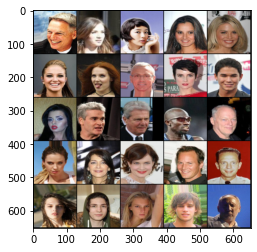

In [ ]:
dataset = Dataset(data_path, size=128, limit=10000)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)
x, y = next(iter(dataloader))
show(x)

# Generator

Conv2d : `(n+2*pad-ks)//stride + 1`<br>
convTranspose2d : `(n-1)*stride - 2*padding + ks`

- n : width or height
- ks : kernel size
- ConvTranspose2d : in_channels, out_channels, kernel_size, stride=1, padding=0

In [ ]:
class Generator(nn.Module):
    def __init__(self, z_dim=64, d_dim=16):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        
        self.gen = nn.Sequential(
            nn.ConvTranspose2d(z_dim, d_dim*32, kernel_size=4, stride=1, padding=0), #200 ->512 ; 1x1 -> 4x4
            # begin with 1 x 1 image with z_dim channels (decrease channel and increase size)
            nn.BatchNorm2d(d_dim*32),
            nn.ReLU(inplace=True),
            
            nn.ConvTranspose2d(d_dim*32, d_dim*16, kernel_size=4, stride=2, padding=1), #512 -> 256 ; 4x4 -> 8x8
            nn.BatchNorm2d(d_dim*16),
            nn.ReLU(inplace=True),
            
            nn.ConvTranspose2d(d_dim*16, d_dim*8, kernel_size=4, stride=2, padding=1), #256 -> 128 ; 8x8 -> 16x16
            nn.BatchNorm2d(d_dim*8),
            nn.ReLU(inplace=True),
            
            nn.ConvTranspose2d(d_dim*8, d_dim*4, kernel_size=4, stride=2, padding=1), #128 -> 64 ; 16x16 -> 32x32
            nn.BatchNorm2d(d_dim*4),
            nn.ReLU(inplace=True),
            
            nn.ConvTranspose2d(d_dim*4, d_dim*2, kernel_size=4, stride=2, padding=1), #64 -> 32 ; 32x32 ->64x64
            nn.BatchNorm2d(d_dim*2),
            nn.ReLU(inplace=True),
            
            nn.ConvTranspose2d(d_dim*2, 3, kernel_size=4, stride=2, padding=1), #32 -> 3 ; 64x64 -> 128x128
            nn.Tanh() # out range [-1, 1]
        )
        
    def forward(self, noise):
        x = noise.view(len(noise), self.z_dim, 1, 1) #128(batch size) x 200(latent space) x 1(width) x 1(height)
        return self.gen(x)

In [ ]:
def gen_noise(num, z_dim, device=device):
    return torch.randn(num, z_dim, device=device) # 128 x 200    

# Critic

In [ ]:
class Critic(nn.Module):
    def __init__(self, d_dim=16):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            nn.Conv2d(3, d_dim, 4, 2, 1), #128x128 -> 64x64 ; 3 -> 16
            nn.InstanceNorm2d(d_dim),
            nn.LeakyReLU(0.2),
            
            nn.Conv2d(d_dim, d_dim*2, 4, 2, 1), #64x64 -> 32x32 ; 16 -> 32
            nn.InstanceNorm2d(d_dim*2),
            nn.LeakyReLU(0.2),
            
            nn.Conv2d(d_dim*2, d_dim*4, 4, 2, 1), #32x32 -> 16x16 ; 32 -> 64
            nn.InstanceNorm2d(d_dim*4),
            nn.LeakyReLU(0.2),
            
            nn.Conv2d(d_dim*4, d_dim*8, 4, 2, 1), #16x16 -> 8x8; 64 -> 128
            nn.InstanceNorm2d(d_dim*8),
            nn.LeakyReLU(0.2),
            
            nn.Conv2d(d_dim*8, d_dim*16, 4, 2, 1), #8x8 -> 4x4; 128->256
            nn.InstanceNorm2d(d_dim*16),
            nn.LeakyReLU(0.2),
            
            nn.Conv2d(d_dim*16, 1, 4, 1, 0) # 4x4 -> 1x1 ; 256->1
        )
    
    def forward(self, image):
        #image : 128(batch)x3(channel)x128x128(w,h)
        crit_pred = self.crit(image) #128(batch)x1(channel)x1x1(w,h)
        return crit_pred.view(len(crit_pred), -1) # 128 x 1

# Initialize Weights (Optional)

In [ ]:
## optional, init your weights in different ways
def init_weights(m):
    if isinstance(m, nn.Conv2d) or isinstance(m,nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias,0)

    if isinstance(m,nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias,0)

##gen=gen.apply(init_weights)
##crit=crit.apply(init_weights)

# Model

In [ ]:
# Models
gen = Generator(z_dim).to(device)
critic = Critic().to(device)

In [ ]:
# Optimizers
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(0.5, 0.9))
critic_opt = torch.optim.Adam(critic.parameters(), lr=lr, betas=(0.5, 0.9))

In [ ]:
#wandb
if(wandbact==1):
    wandb.watch(gen, log_freq=100)
    wandb.watch(critic, log_freq=100)

# Gradient Penalty Calculation

In [ ]:
def get_grad_penalty(real, fake, critic, alpha, gamma=10):
    mix_images = real*alpha + fake*(1-alpha) #128(batch)x3(channel)x128x128(w,h)
    mix_scores = critic(mix_images) #128x1
    
    gradient = torch.autograd.grad(
        inputs = mix_images,
        outputs = mix_scores,
        grad_outputs = torch.ones_like(mix_scores),
        retain_graph=True,
        create_graph=True
    )[0] #128x3x128x128
    
    gradient = gradient.view(len(gradient), -1) #128x 49152(128*128*3)
    gradient_norm = gradient.norm(2, dim=1)# 2 - L2 norm only on 49152
    grad_penalty = gamma*((gradient_norm-1)**2).mean()
    
    return grad_penalty

# Save Checkpoints

In [ ]:
def save_chckpt(name):
    torch.save({
        'epoch':epoch,
        'model_state_dict':gen.state_dict(),
        'optimizer_state_dict':gen_opt.state_dict()
    }, f"{checkpt_path}G-{name}.pkl")
    
    torch.save({
        'epoch':epoch,
        'model_state_dict':critic.state_dict(),
        'optimizer_state_dict':critic_opt.state_dict()
    }, f"{checkpt_path}Critic-{name}.pkl")
    
    print(f"Saved Checkpoint:\n\t Epoch : {epoch}")

# Load Checkpoint

In [ ]:
def load_chckpt(name):
    checkpoint = torch.load(f"{checkpt_path}G-{name}.pkl")
    gen.load_state_dict(checkpoint['model_state_dict'])
    gen_opt.load_state_dict(checkpoint['optimizer_state_dict'])
    
    checkpoint = torch.load(f"{checkpt_path}Critic-{name}.pkl")
    critic.load_state_dict(checkpoint['model_state_dict'])
    critic_opt.load_state_dict(checkpoint['optimizer_state_dict'])
    
    last_epoch = checkpoint['epoch']

    print(f"Checkpoint Loaded:\n\t Epoch : {last_epoch}")
    return last_epoch

# Load From Previous Checkpoint

In [ ]:
#last_epoch = load_chckpt("Checkpoint")

# Training Loop

  0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/78 [00:00<?, ?it/s]

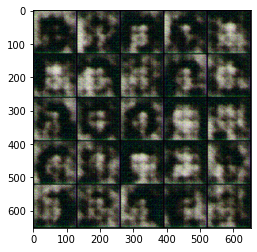

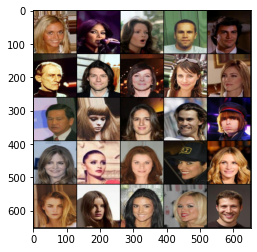

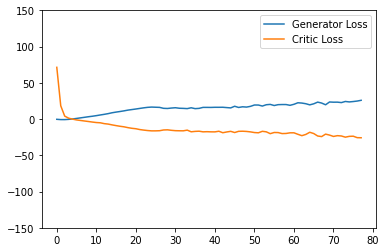

Epoch : 0; Generator Loss : 15.061410650993006; Critic Loss : -14.012772186444359

Saved Checkpoint:
	 Epoch : 0


  0%|          | 0/78 [00:00<?, ?it/s]

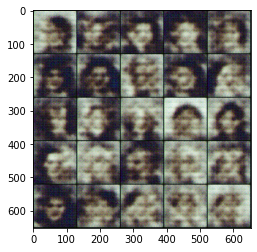

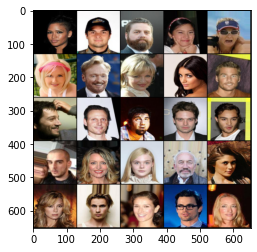

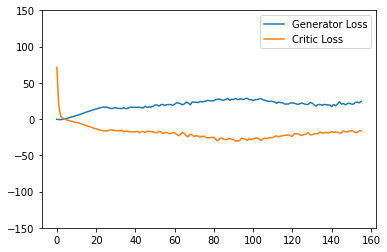

Epoch : 1; Generator Loss : 23.4530120018201; Critic Loss : -23.041519096570138

Saved Checkpoint:
	 Epoch : 1


  0%|          | 0/78 [00:00<?, ?it/s]

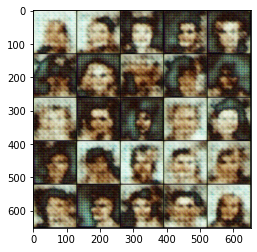

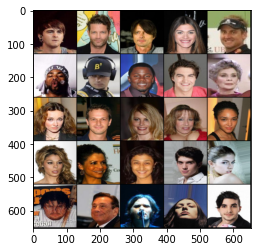

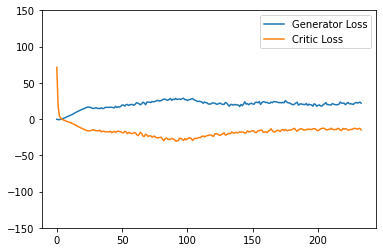

Epoch : 2; Generator Loss : 21.34376958700327; Critic Loss : -14.69183618105375

Saved Checkpoint:
	 Epoch : 2


  0%|          | 0/78 [00:00<?, ?it/s]

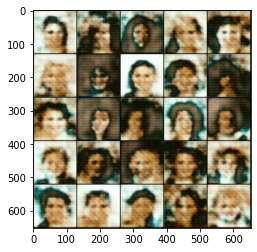

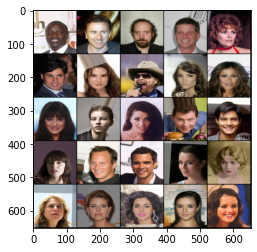

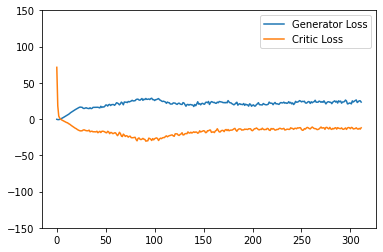

Epoch : 3; Generator Loss : 23.478789451794746; Critic Loss : -12.950369120866823

Saved Checkpoint:
	 Epoch : 3


  0%|          | 0/78 [00:00<?, ?it/s]

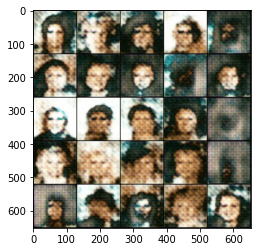

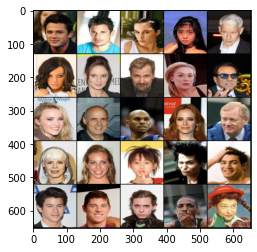

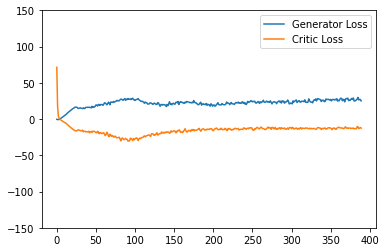

Epoch : 4; Generator Loss : 26.173174222310383; Critic Loss : -12.67126445525732

Saved Checkpoint:
	 Epoch : 4


  0%|          | 0/78 [00:00<?, ?it/s]

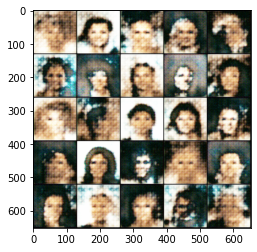

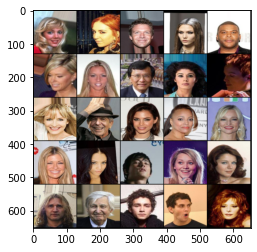

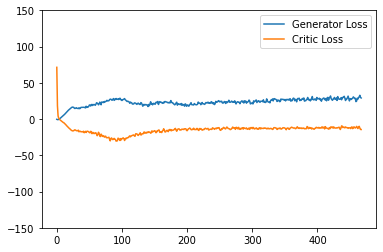

Epoch : 5; Generator Loss : 28.181929001441368; Critic Loss : -12.043660704294838

Saved Checkpoint:
	 Epoch : 5


  0%|          | 0/78 [00:00<?, ?it/s]

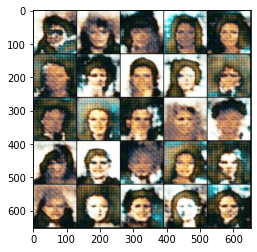

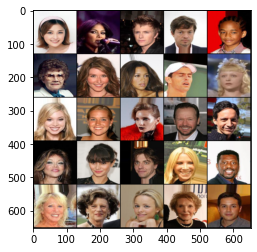

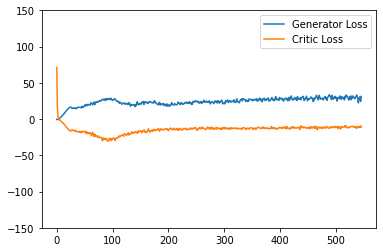

Epoch : 6; Generator Loss : 29.463641215593388; Critic Loss : -11.244439733945406

Saved Checkpoint:
	 Epoch : 6


  0%|          | 0/78 [00:00<?, ?it/s]

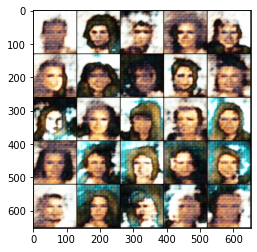

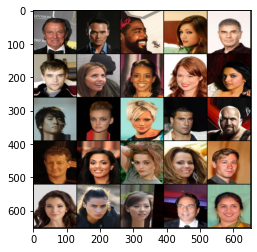

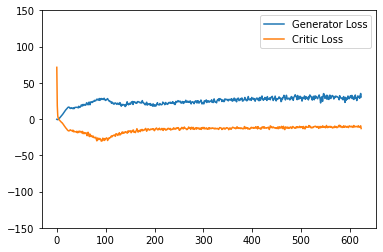

Epoch : 7; Generator Loss : 29.941226250086075; Critic Loss : -10.624678770701088

Saved Checkpoint:
	 Epoch : 7


  0%|          | 0/78 [00:00<?, ?it/s]

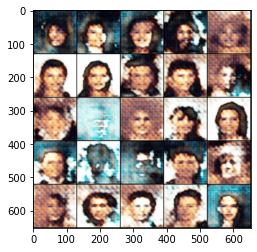

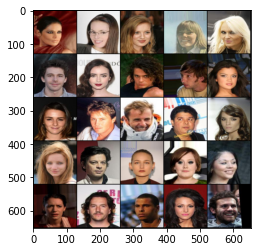

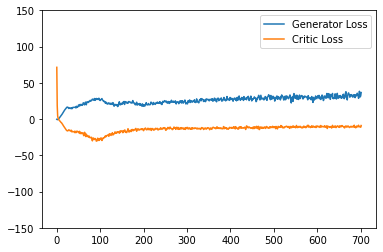

Epoch : 8; Generator Loss : 31.879060085003193; Critic Loss : -10.444794629170348

Saved Checkpoint:
	 Epoch : 8


  0%|          | 0/78 [00:00<?, ?it/s]

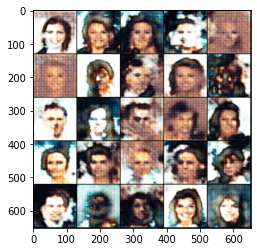

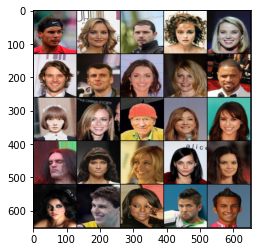

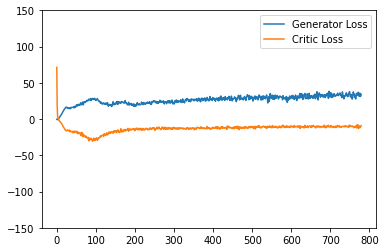

Epoch : 9; Generator Loss : 32.965358147254356; Critic Loss : -10.298464558674741

Saved Checkpoint:
	 Epoch : 9


  0%|          | 0/78 [00:00<?, ?it/s]

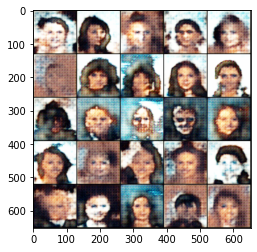

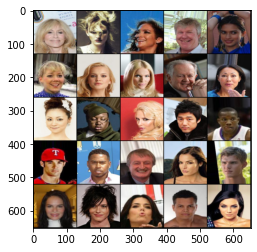

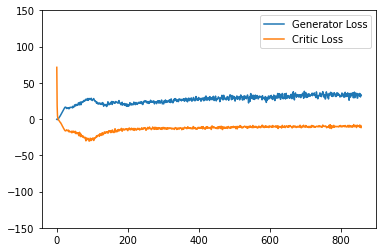

Epoch : 10; Generator Loss : 33.26115026229467; Critic Loss : -10.006837836290016

Saved Checkpoint:
	 Epoch : 10


  0%|          | 0/78 [00:00<?, ?it/s]

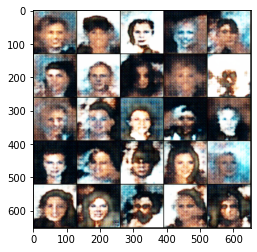

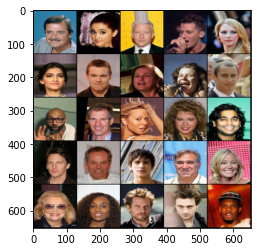

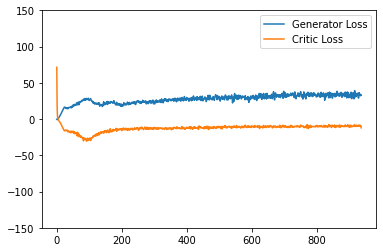

Epoch : 11; Generator Loss : 33.656181897872536; Critic Loss : -9.575017425341484

Saved Checkpoint:
	 Epoch : 11


  0%|          | 0/78 [00:00<?, ?it/s]

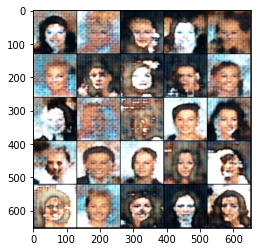

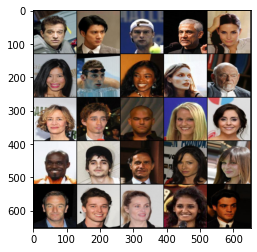

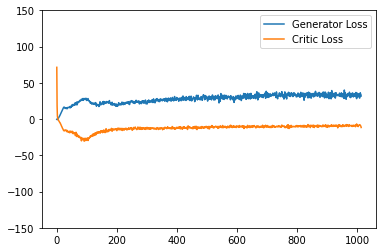

Epoch : 12; Generator Loss : 33.07298530676426; Critic Loss : -9.01872018178304

Saved Checkpoint:
	 Epoch : 12


  0%|          | 0/78 [00:00<?, ?it/s]

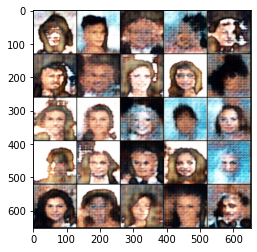

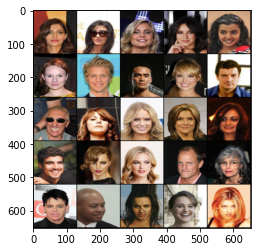

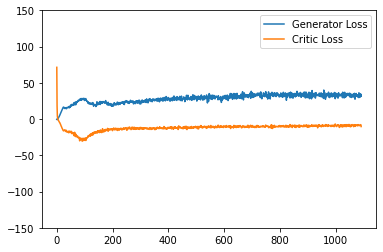

Epoch : 13; Generator Loss : 32.94757099640675; Critic Loss : -8.818293410081132

Saved Checkpoint:
	 Epoch : 13


  0%|          | 0/78 [00:00<?, ?it/s]

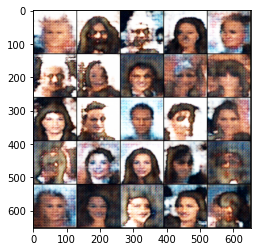

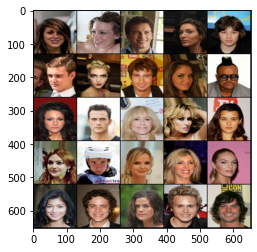

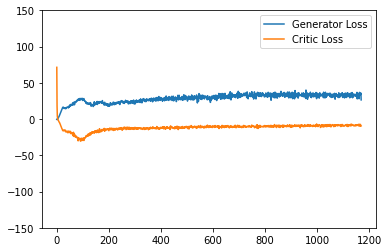

Epoch : 14; Generator Loss : 32.82966934106289; Critic Loss : -8.540697387548594

Saved Checkpoint:
	 Epoch : 14


  0%|          | 0/78 [00:00<?, ?it/s]

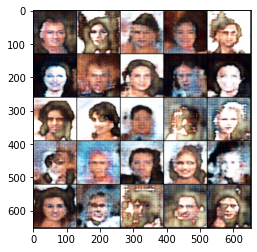

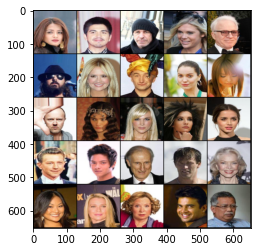

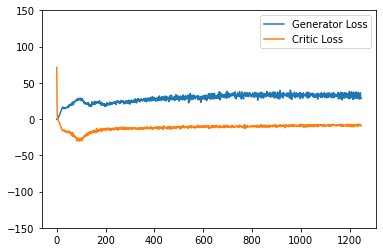

Epoch : 15; Generator Loss : 32.58354570926764; Critic Loss : -8.651842630826508

Saved Checkpoint:
	 Epoch : 15


  0%|          | 0/78 [00:00<?, ?it/s]

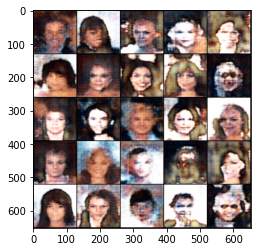

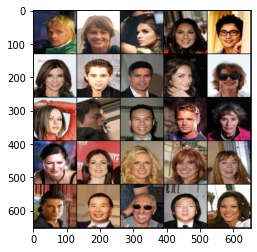

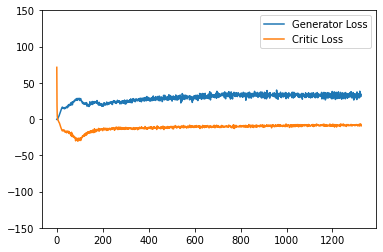

Epoch : 16; Generator Loss : 32.65566644913111; Critic Loss : -8.338385317875789

Saved Checkpoint:
	 Epoch : 16


  0%|          | 0/78 [00:00<?, ?it/s]

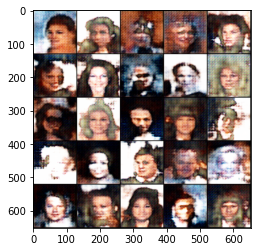

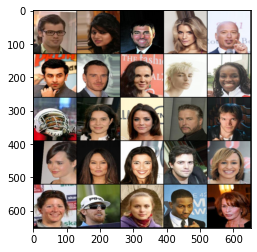

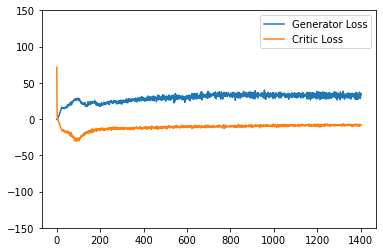

Epoch : 17; Generator Loss : 31.838952015607784; Critic Loss : -8.295411781164322

Saved Checkpoint:
	 Epoch : 17


  0%|          | 0/78 [00:00<?, ?it/s]

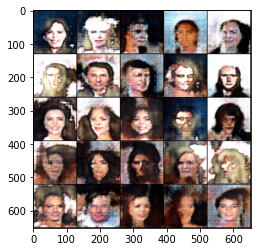

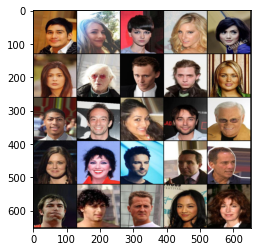

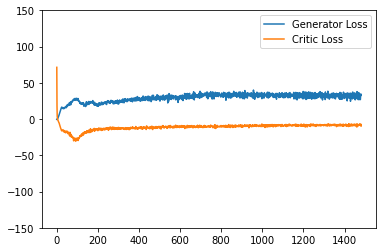

Epoch : 18; Generator Loss : 31.740285237630207; Critic Loss : -8.224304720682975

Saved Checkpoint:
	 Epoch : 18


  0%|          | 0/78 [00:00<?, ?it/s]

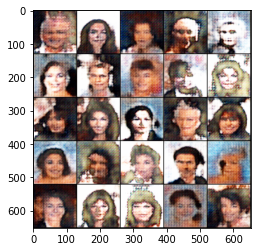

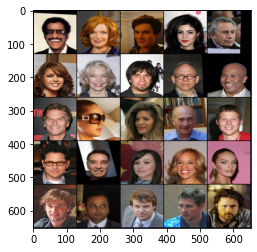

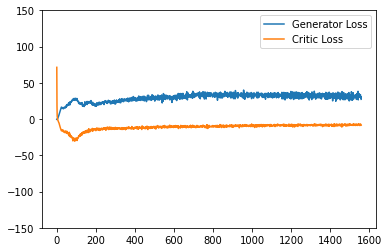

Epoch : 19; Generator Loss : 31.357272294851448; Critic Loss : -7.855562876432368

Saved Checkpoint:
	 Epoch : 19


  0%|          | 0/78 [00:00<?, ?it/s]

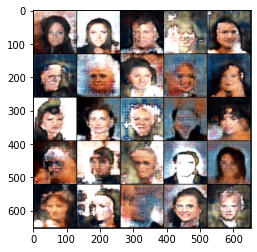

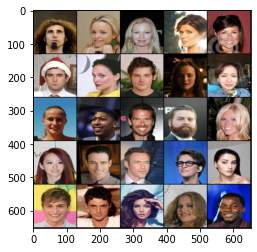

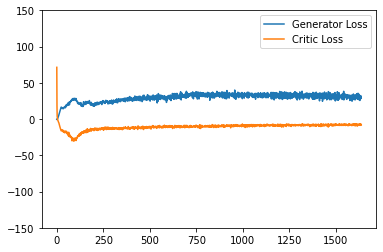

Epoch : 20; Generator Loss : 30.653741078499035; Critic Loss : -7.768663068918079

Saved Checkpoint:
	 Epoch : 20


  0%|          | 0/78 [00:00<?, ?it/s]

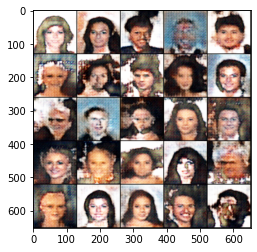

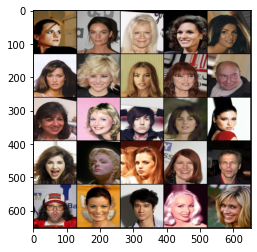

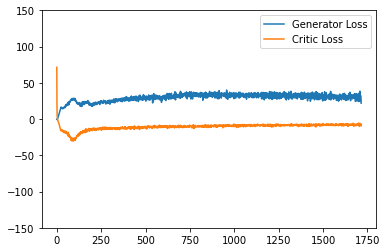

Epoch : 21; Generator Loss : 30.556984485724033; Critic Loss : -7.817995865528399

Saved Checkpoint:
	 Epoch : 21


  0%|          | 0/78 [00:00<?, ?it/s]

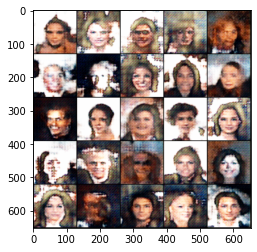

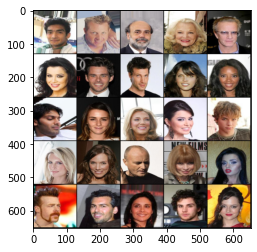

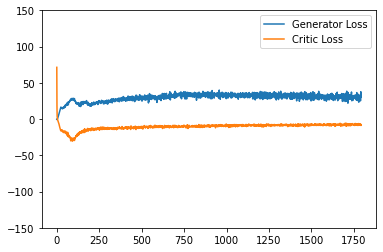

Epoch : 22; Generator Loss : 30.308668674566807; Critic Loss : -7.603607567762718

Saved Checkpoint:
	 Epoch : 22


  0%|          | 0/78 [00:00<?, ?it/s]

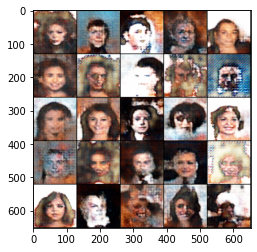

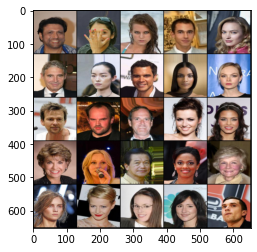

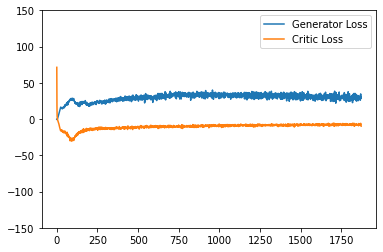

Epoch : 23; Generator Loss : 29.504112879435223; Critic Loss : -7.695825166580003

Saved Checkpoint:
	 Epoch : 23


  0%|          | 0/78 [00:00<?, ?it/s]

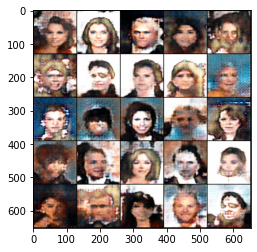

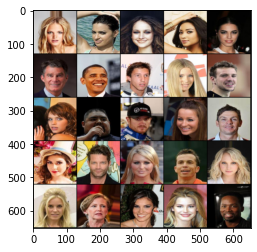

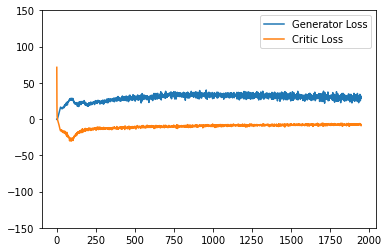

Epoch : 24; Generator Loss : 29.291322585863945; Critic Loss : -7.453573154180477

Saved Checkpoint:
	 Epoch : 24


  0%|          | 0/78 [00:00<?, ?it/s]

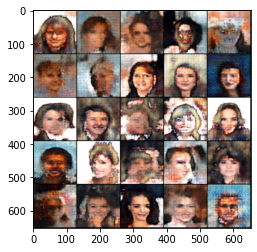

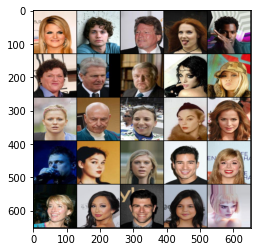

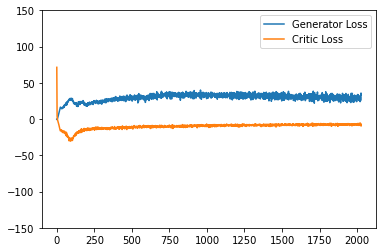

Epoch : 25; Generator Loss : 28.92087530478453; Critic Loss : -7.4394900065202

Saved Checkpoint:
	 Epoch : 25


  0%|          | 0/78 [00:00<?, ?it/s]

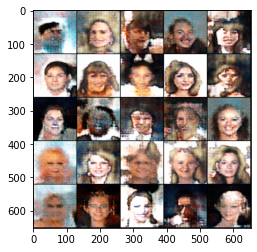

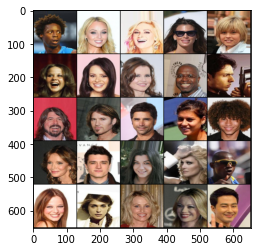

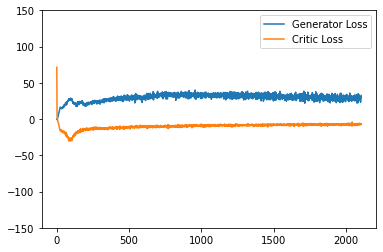

Epoch : 26; Generator Loss : 28.8556489944458; Critic Loss : -7.355621703465779

Saved Checkpoint:
	 Epoch : 26


  0%|          | 0/78 [00:00<?, ?it/s]

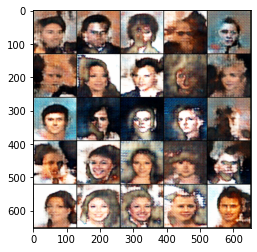

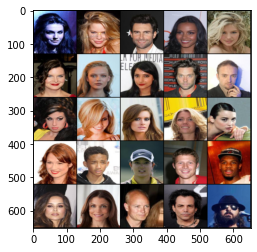

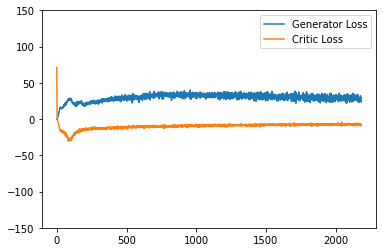

Epoch : 27; Generator Loss : 28.50621103629088; Critic Loss : -7.286242306538114

Saved Checkpoint:
	 Epoch : 27


  0%|          | 0/78 [00:00<?, ?it/s]

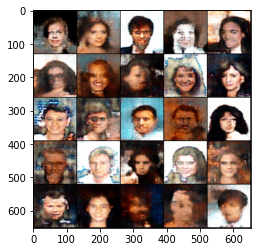

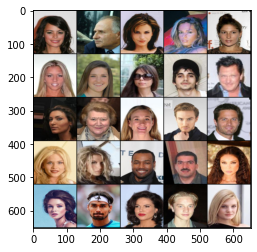

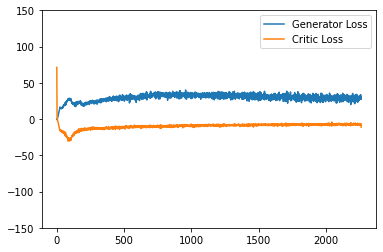

Epoch : 28; Generator Loss : 28.186359527783516; Critic Loss : -7.249487496033692

Saved Checkpoint:
	 Epoch : 28


  0%|          | 0/78 [00:00<?, ?it/s]

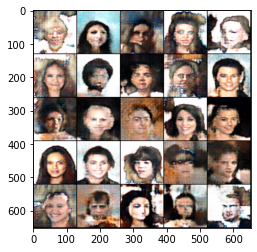

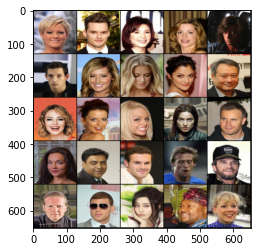

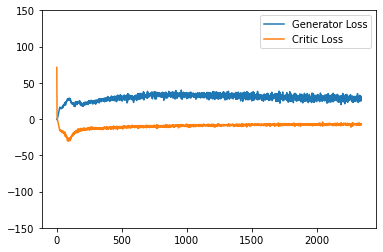

Epoch : 29; Generator Loss : 27.712124311006985; Critic Loss : -7.154460517871077

Saved Checkpoint:
	 Epoch : 29


  0%|          | 0/78 [00:00<?, ?it/s]

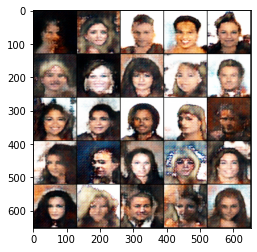

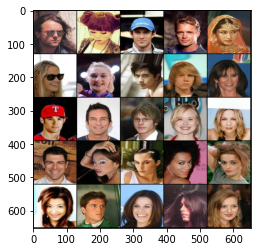

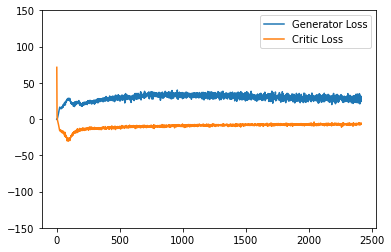

Epoch : 30; Generator Loss : 27.482872009277344; Critic Loss : -7.067255102671108

Saved Checkpoint:
	 Epoch : 30


  0%|          | 0/78 [00:00<?, ?it/s]

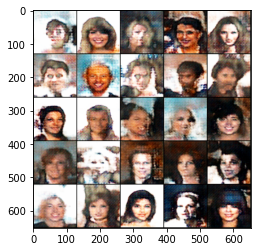

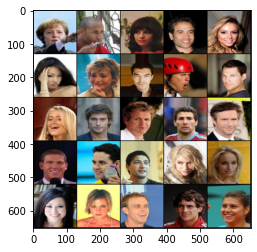

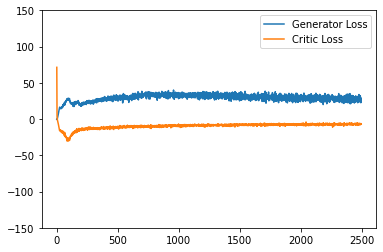

Epoch : 31; Generator Loss : 27.663129024016552; Critic Loss : -6.9940053475208765

Saved Checkpoint:
	 Epoch : 31


  0%|          | 0/78 [00:00<?, ?it/s]

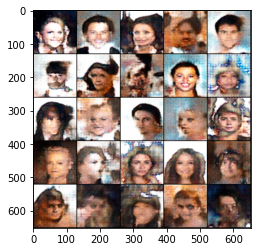

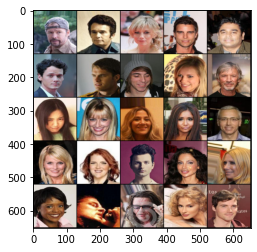

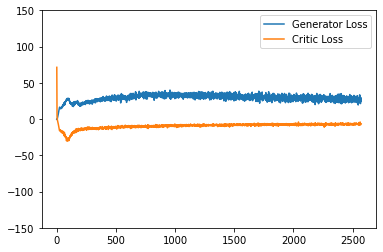

Epoch : 32; Generator Loss : 27.13642978668213; Critic Loss : -6.921969612745138

Saved Checkpoint:
	 Epoch : 32


  0%|          | 0/78 [00:00<?, ?it/s]

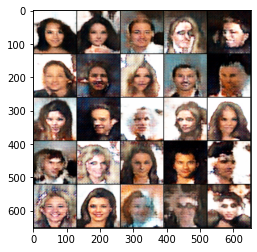

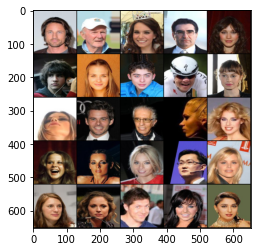

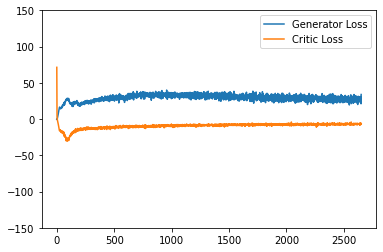

Epoch : 33; Generator Loss : 27.508593559265137; Critic Loss : -6.80612897444994

Saved Checkpoint:
	 Epoch : 33


  0%|          | 0/78 [00:00<?, ?it/s]

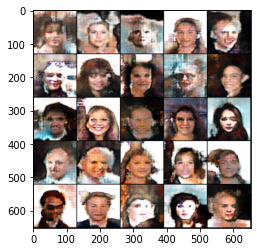

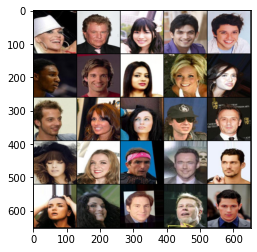

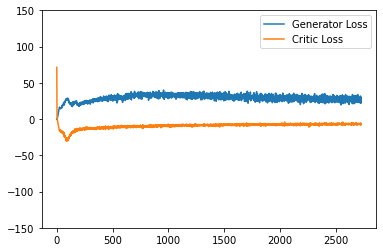

Epoch : 34; Generator Loss : 27.018897496736965; Critic Loss : -6.770950197562191

Saved Checkpoint:
	 Epoch : 34


  0%|          | 0/78 [00:00<?, ?it/s]

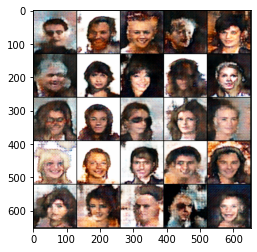

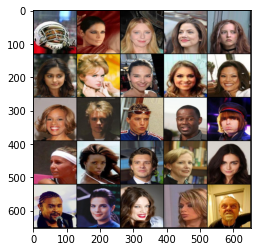

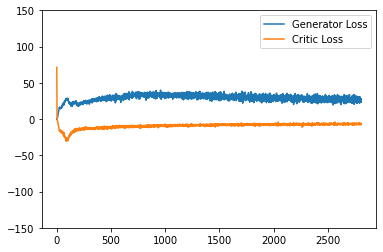

Epoch : 35; Generator Loss : 27.066743459457005; Critic Loss : -6.7345845644290625

Saved Checkpoint:
	 Epoch : 35


  0%|          | 0/78 [00:00<?, ?it/s]

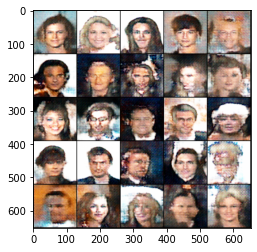

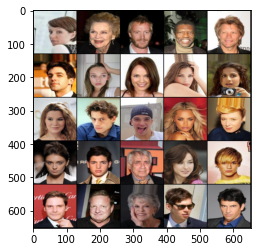

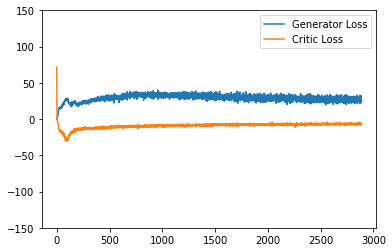

Epoch : 36; Generator Loss : 26.862419177324345; Critic Loss : -6.782844932874044

Saved Checkpoint:
	 Epoch : 36


  0%|          | 0/78 [00:00<?, ?it/s]

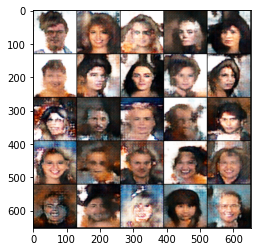

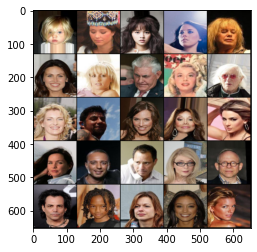

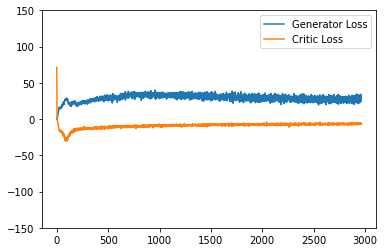

Epoch : 37; Generator Loss : 27.057491204677483; Critic Loss : -6.59141672452291

Saved Checkpoint:
	 Epoch : 37


  0%|          | 0/78 [00:00<?, ?it/s]

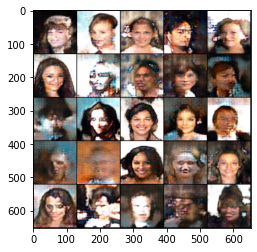

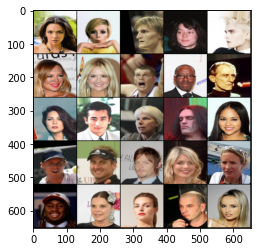

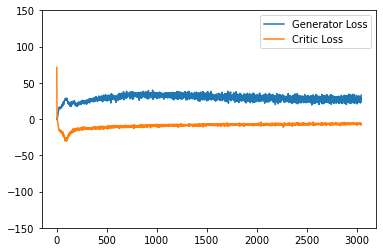

Epoch : 38; Generator Loss : 26.375670310778496; Critic Loss : -6.589930803959185

Saved Checkpoint:
	 Epoch : 38


  0%|          | 0/78 [00:00<?, ?it/s]

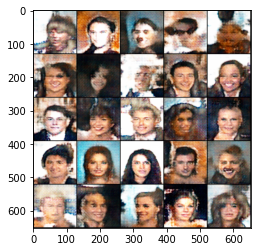

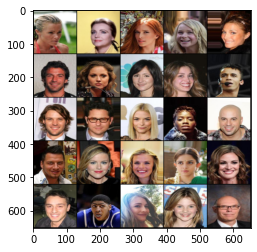

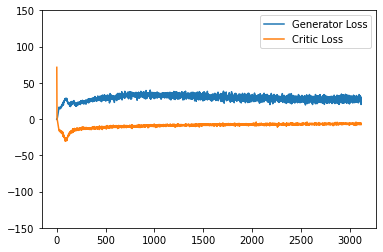

Epoch : 39; Generator Loss : 26.991135572775818; Critic Loss : -6.547896263538261

Saved Checkpoint:
	 Epoch : 39


  0%|          | 0/78 [00:00<?, ?it/s]

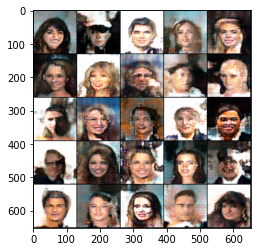

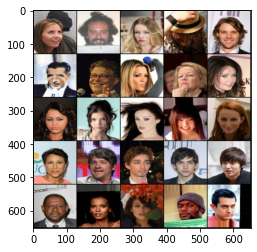

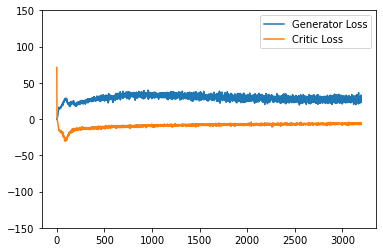

Epoch : 40; Generator Loss : 26.737132096901917; Critic Loss : -6.489757480988134

Saved Checkpoint:
	 Epoch : 40


  0%|          | 0/78 [00:00<?, ?it/s]

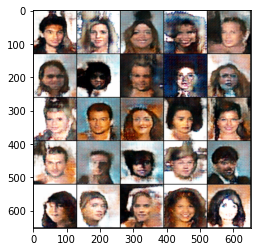

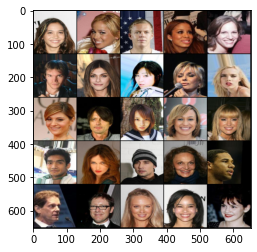

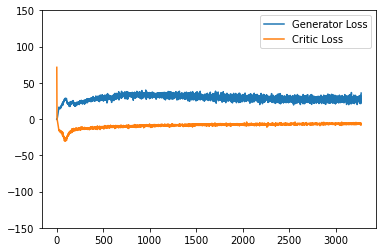

Epoch : 41; Generator Loss : 26.88861756447034; Critic Loss : -6.445832100281346

Saved Checkpoint:
	 Epoch : 41


  0%|          | 0/78 [00:00<?, ?it/s]

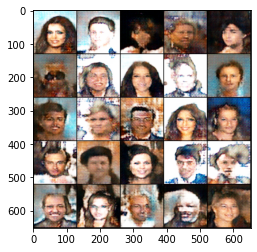

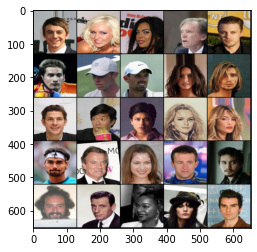

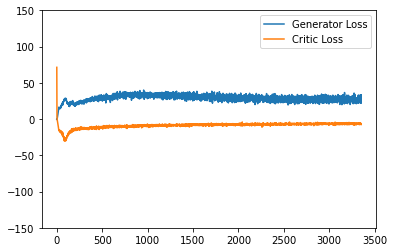

Epoch : 42; Generator Loss : 26.471995622683796; Critic Loss : -6.376410012978776

Saved Checkpoint:
	 Epoch : 42


  0%|          | 0/78 [00:00<?, ?it/s]

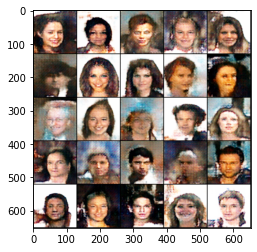

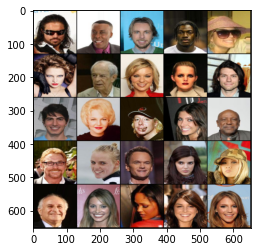

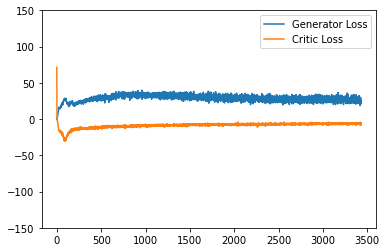

Epoch : 43; Generator Loss : 26.62275749597794; Critic Loss : -6.460680707907063

Saved Checkpoint:
	 Epoch : 43


  0%|          | 0/78 [00:00<?, ?it/s]

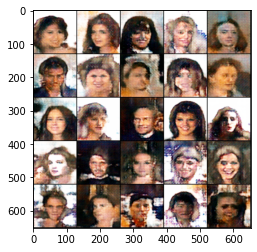

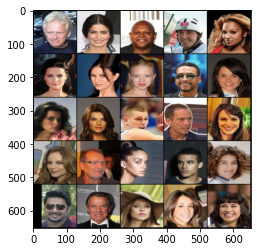

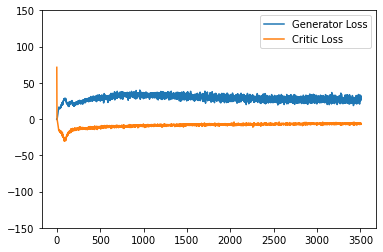

Epoch : 44; Generator Loss : 26.7624150789701; Critic Loss : -6.299373707404501

Saved Checkpoint:
	 Epoch : 44


  0%|          | 0/78 [00:00<?, ?it/s]

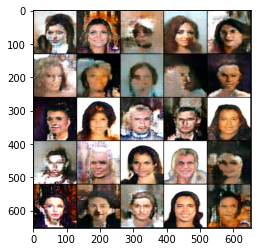

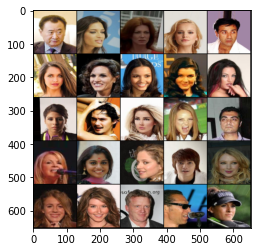

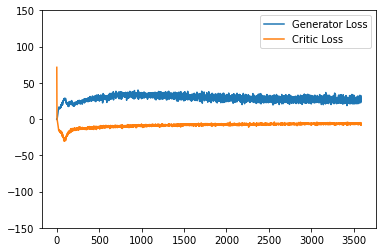

Epoch : 45; Generator Loss : 26.489521637941017; Critic Loss : -6.414622115171874

Saved Checkpoint:
	 Epoch : 45


  0%|          | 0/78 [00:00<?, ?it/s]

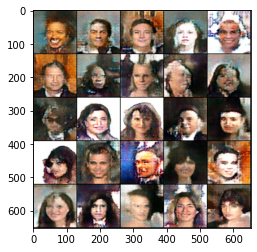

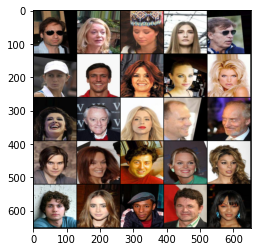

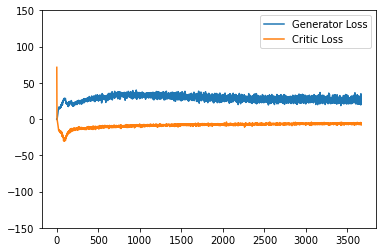

Epoch : 46; Generator Loss : 26.69330386626415; Critic Loss : -6.41116326863949

Saved Checkpoint:
	 Epoch : 46


  0%|          | 0/78 [00:00<?, ?it/s]

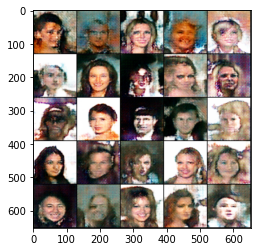

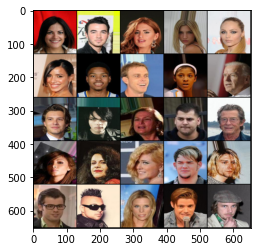

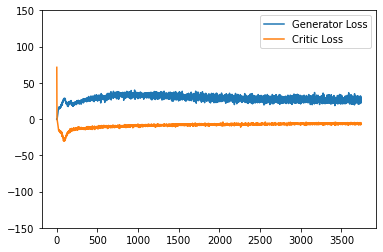

Epoch : 47; Generator Loss : 26.62361942193447; Critic Loss : -6.284772067192273

Saved Checkpoint:
	 Epoch : 47


  0%|          | 0/78 [00:00<?, ?it/s]

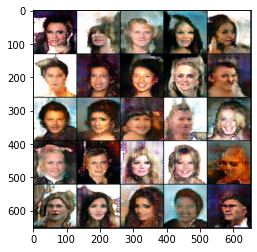

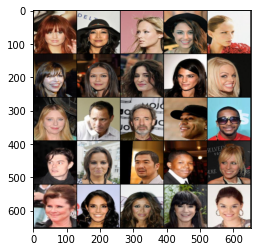

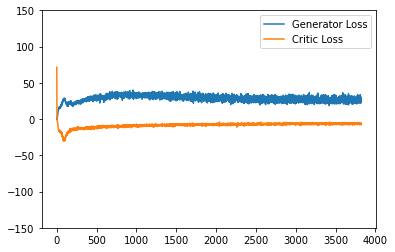

Epoch : 48; Generator Loss : 26.37810423435309; Critic Loss : -6.368504525759281

Saved Checkpoint:
	 Epoch : 48


  0%|          | 0/78 [00:00<?, ?it/s]

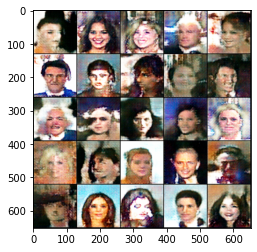

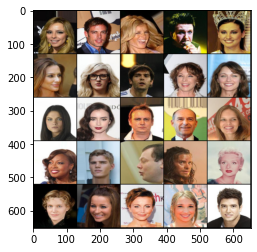

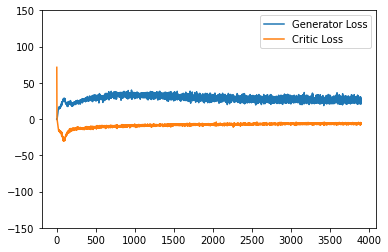

Epoch : 49; Generator Loss : 26.165201578384792; Critic Loss : -6.228982559228554

Saved Checkpoint:
	 Epoch : 49


  0%|          | 0/78 [00:00<?, ?it/s]

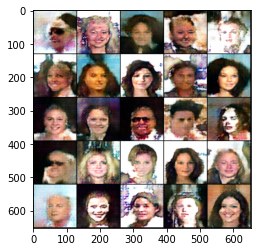

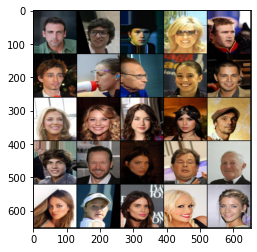

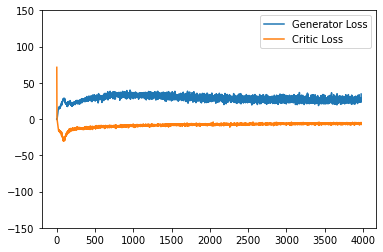

Epoch : 50; Generator Loss : 26.64754202427008; Critic Loss : -6.245706266011949

Saved Checkpoint:
	 Epoch : 50


  0%|          | 0/78 [00:00<?, ?it/s]

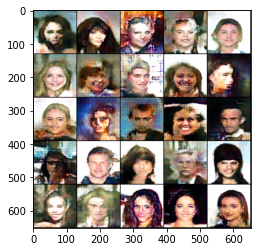

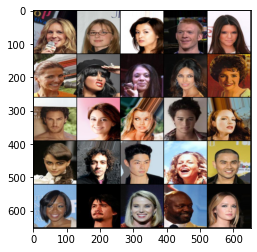

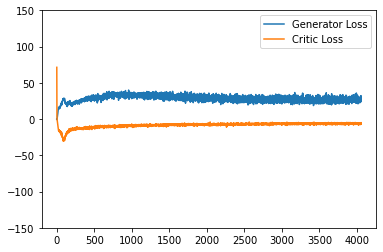

Epoch : 51; Generator Loss : 26.757087756425907; Critic Loss : -6.254006230525481

Saved Checkpoint:
	 Epoch : 51


  0%|          | 0/78 [00:00<?, ?it/s]

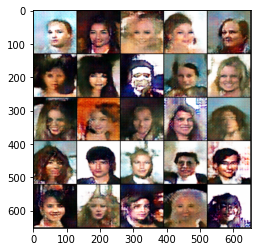

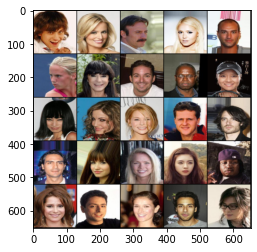

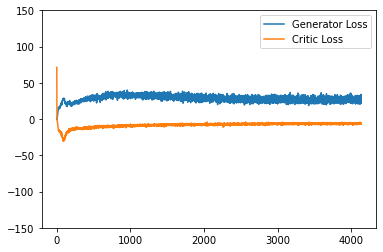

Epoch : 52; Generator Loss : 26.278916579026443; Critic Loss : -6.245936410549359

Saved Checkpoint:
	 Epoch : 52


  0%|          | 0/78 [00:00<?, ?it/s]

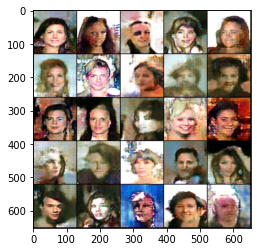

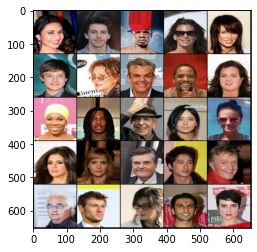

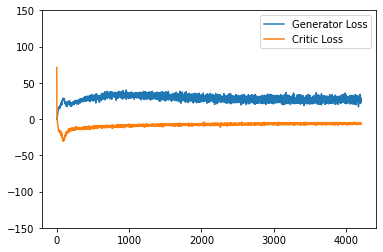

Epoch : 53; Generator Loss : 26.555915270096218; Critic Loss : -6.234730073733205

Saved Checkpoint:
	 Epoch : 53


  0%|          | 0/78 [00:00<?, ?it/s]

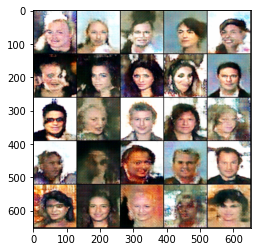

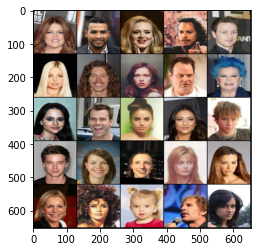

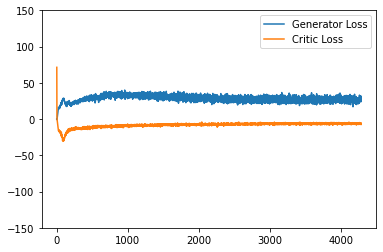

Epoch : 54; Generator Loss : 26.178512206444374; Critic Loss : -6.282168733767975

Saved Checkpoint:
	 Epoch : 54


  0%|          | 0/78 [00:00<?, ?it/s]

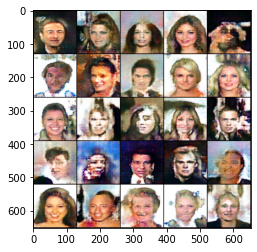

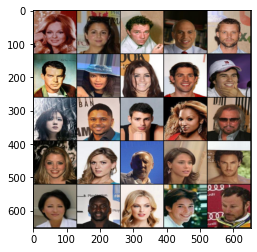

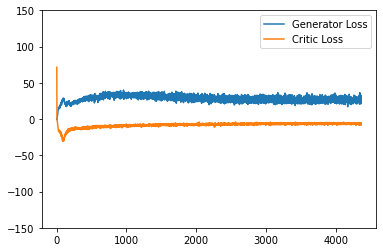

Epoch : 55; Generator Loss : 26.552758461389786; Critic Loss : -6.217576424892132

Saved Checkpoint:
	 Epoch : 55


  0%|          | 0/78 [00:00<?, ?it/s]

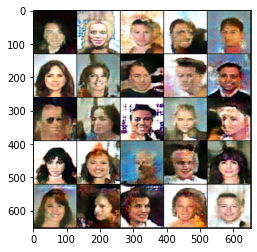

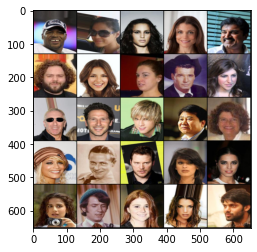

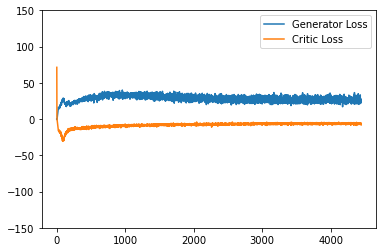

Epoch : 56; Generator Loss : 26.596161500001564; Critic Loss : -6.315012363287121

Saved Checkpoint:
	 Epoch : 56


  0%|          | 0/78 [00:00<?, ?it/s]

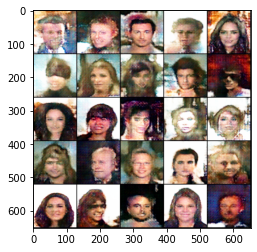

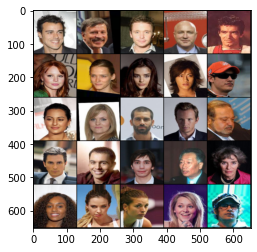

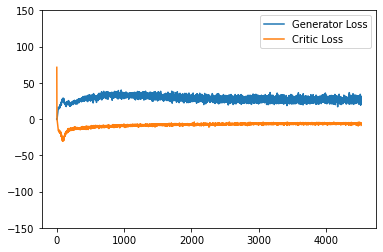

Epoch : 57; Generator Loss : 26.42184453132825; Critic Loss : -6.307974312855646

Saved Checkpoint:
	 Epoch : 57


  0%|          | 0/78 [00:00<?, ?it/s]

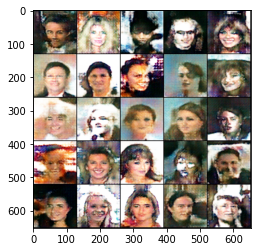

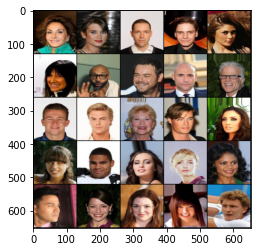

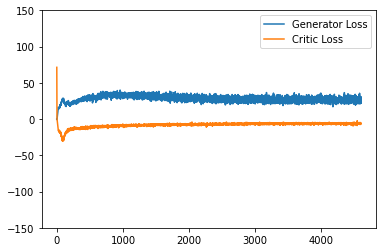

Epoch : 58; Generator Loss : 26.26940763913668; Critic Loss : -6.256116370360057

Saved Checkpoint:
	 Epoch : 58


  0%|          | 0/78 [00:00<?, ?it/s]

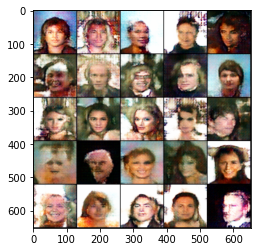

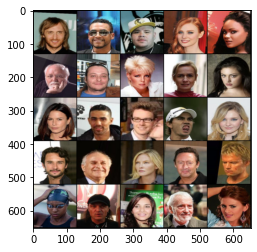

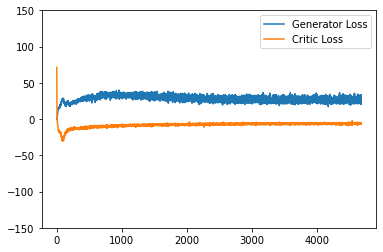

Epoch : 59; Generator Loss : 26.747154944982285; Critic Loss : -6.263866678873699

Saved Checkpoint:
	 Epoch : 59


  0%|          | 0/78 [00:00<?, ?it/s]

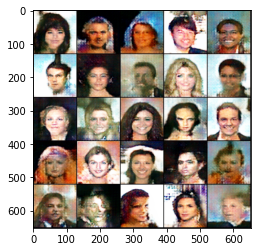

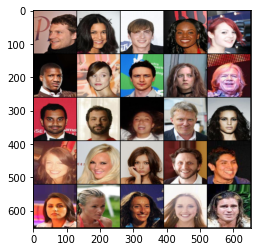

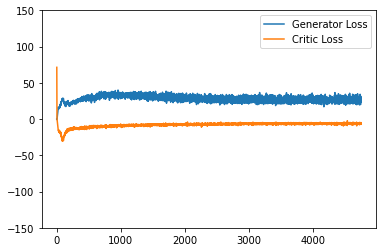

Epoch : 60; Generator Loss : 26.505442301432293; Critic Loss : -6.2681650858659

Saved Checkpoint:
	 Epoch : 60


  0%|          | 0/78 [00:00<?, ?it/s]

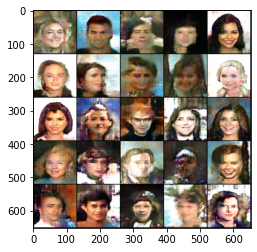

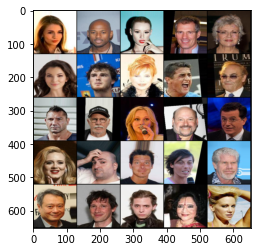

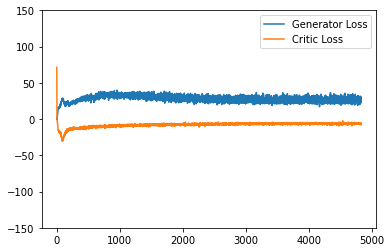

Epoch : 61; Generator Loss : 26.2097903520633; Critic Loss : -6.303333586912888

Saved Checkpoint:
	 Epoch : 61


  0%|          | 0/78 [00:00<?, ?it/s]

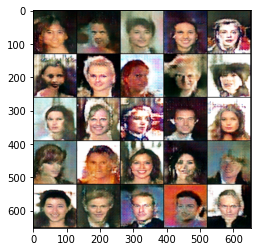

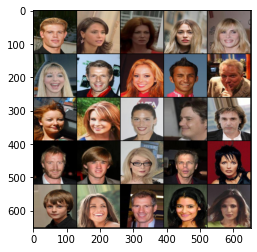

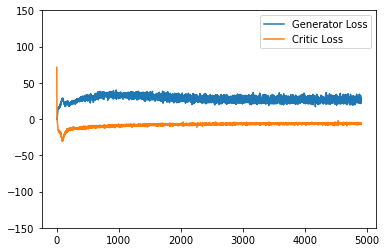

Epoch : 62; Generator Loss : 26.68441327412923; Critic Loss : -6.321371374374782

Saved Checkpoint:
	 Epoch : 62


  0%|          | 0/78 [00:00<?, ?it/s]

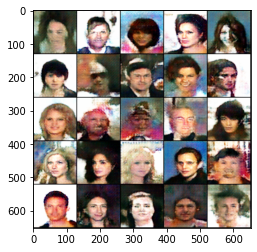

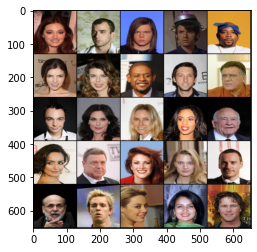

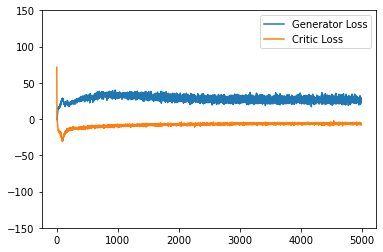

Epoch : 63; Generator Loss : 26.031297757075382; Critic Loss : -6.257914363726591

Saved Checkpoint:
	 Epoch : 63


  0%|          | 0/78 [00:00<?, ?it/s]

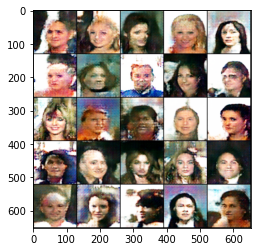

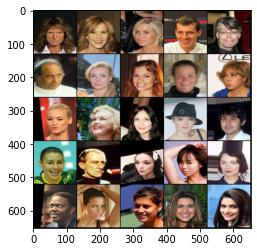

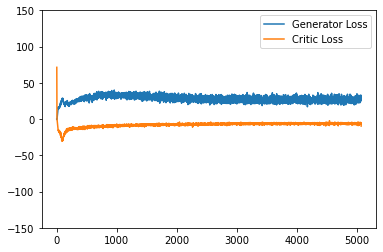

Epoch : 64; Generator Loss : 26.746412228315304; Critic Loss : -6.365579457466418

Saved Checkpoint:
	 Epoch : 64


  0%|          | 0/78 [00:00<?, ?it/s]

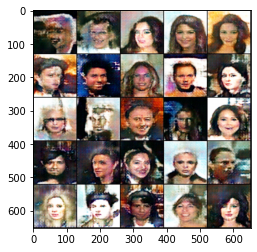

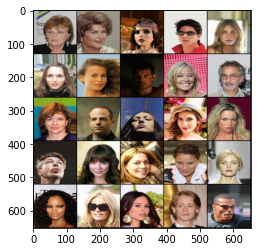

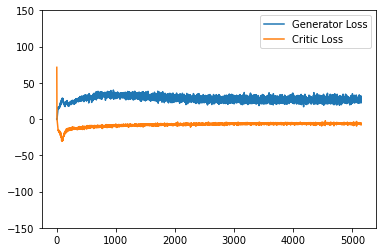

Epoch : 65; Generator Loss : 26.574737548828125; Critic Loss : -6.276289524787511

Saved Checkpoint:
	 Epoch : 65


  0%|          | 0/78 [00:00<?, ?it/s]

In [ ]:
pbar1 = tqdm(range(epochs))
pbar1.n = last_epoch
pbar1.refresh()
for epoch in range(last_epoch,epochs):
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real) #128
        real=real.to(device)
        
        #Critic
        mean_critic_loss = 0
        for i in range(crit_cycles): # 5 times critic 1 time generator
            critic_opt.zero_grad()
            
            noise = gen_noise(cur_batch_size, z_dim, device)
            fake = gen(noise)
            critic_fake_pred = critic(fake.detach())
            critic_real_pred = critic(real)
            
            alpha = torch.rand(len(real), 1,1,1, device=device, requires_grad=True) #128x1x1x1
            grad_penalty = get_grad_penalty(real, fake.detach(), critic, alpha)
            
            crit_loss = critic_fake_pred.mean() - critic_real_pred.mean() + grad_penalty
            
            mean_critic_loss+=crit_loss.item() / crit_cycles
            
            crit_loss.backward(retain_graph=True)
            critic_opt.step()
        crit_losses+=[mean_critic_loss]
        
        #generator
        gen_opt.zero_grad()
        noise = gen_noise(cur_batch_size, z_dim, device)
        fake = gen(noise)
        critic_fake_pred = critic(fake)
        
        gen_loss = -critic_fake_pred.mean()
        gen_loss.backward()
        gen_opt.step()
        
        gen_losses+=[gen_loss.item()]
        
    if(wandbact==1):
        wandb.log({'Epoch':epoch, 'Critic Loss':mean_critic_loss, 'Generator Loss':gen_loss})

    show(fake, wandbactive=1, name='fake')
    show(real, wandbactive=1, name='real')

    gen_mean = sum(gen_losses[-len(dataloader):]) / len(dataloader)
    critic_mean = sum(crit_losses[-len(dataloader):]) / len(dataloader)

    plt.plot(range(len(gen_losses)), torch.Tensor(gen_losses), label='Generator Loss')
    plt.plot(range(len(gen_losses)), torch.Tensor(crit_losses), label='Critic Loss')
    plt.ylim(-150, 150)
    plt.legend()
    plt.show()
    print(f"Epoch : {epoch}; Generator Loss : {gen_mean}; Critic Loss : {critic_mean}\n")

    save_chckpt("Checkpoint")
        
    pbar1.update()

`10000 / 128 = 78.125 steps`<br>
`50000 / 128 = 390.625 steps`